# Informtion Visualization 
# Final Project

#### Name:  Manali Tanna
#### Net ID: mut8188

# Data Preprocessing

Data Source: https://github.com/BloombergGraphics/2024-h1b-immigration-data/tree/main

In [2]:
#imports
import altair as alt
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

from vega_datasets import data
from shapely.geometry import Point
from datetime import datetime, timedelta

In [3]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [4]:
# Load the H1-B data for 2024 single

# Single registrations
df_single = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2024_single_reg.csv')

/var/folders/96/zk8xrbrn2c92q4q77nf2c3700000gn/T/ipykernel_44264/1252433580.py:4: DtypeWarning: Columns (4,7,14,16,29,40,44,50,51,52,55) have mixed types. Specify dtype option on import or set low_memory=False.
  df_single = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2024_single_reg.csv')


The data has 350103 rows of data and 56 columns.
Let's reduce this in order to make our visualization easy!

In [5]:
df_single.shape

(350103, 56)

In [6]:
df_single.columns

Index(['bcn', 'country_of_birth', 'country_of_nationality',
       'ben_date_of_birth', 'ben_year_of_birth', 'gender', 'employer_name',
       'FEIN', 'mail_addr', 'city', 'state', 'zip', 'agent_first_name',
       'agent_last_name', 'lottery_year', 'status_type', 'ben_multi_reg_ind',
       'RECEIPT_NUMBER', 'rec_date', 'FIRST_DECISION', 'first_decision_date',
       'i129_employer_name', 'PET_STREET', 'PET_CITY', 'PET_STATE', 'PET_ZIP',
       'REQUESTED_CLASS', 'BASIS_FOR_CLASSIFICATION', 'REQUESTED_ACTION',
       'NUMBER_OF_BENEFICIARIES', 'BEN_SEX', 'BEN_COUNTRY_OF_BIRTH',
       'BEN_CURRENT_CLASS', 'JOB_TITLE', 'DOL_ETA_CASE_NUMBER',
       'WORKSITE_STREET', 'WORKSITE_CITY', 'WORKSITE_STATE', 'WORKSITE_ZIP',
       'FULL_TIME_IND', 'WAGE_AMT', 'WAGE_UNIT', 'valid_from', 'valid_to',
       'NUM_OF_EMP_IN_US', 'S1Q1A', 'S1Q1B', 'BEN_EDUCATION_CODE',
       'ED_LEVEL_DEFINITION', 'BEN_PFIELD_OF_STUDY', 'BEN_COMP_PAID',
       'DOT_CODE', 'NAICS_CODE', 'S3Q1', 'S4Q1', 'T_U_VAWA_FL

In [7]:
df_single

,bcn,country_of_birth,country_of_nationality,ben_date_of_birth,ben_year_of_birth,gender,employer_name,FEIN,mail_addr,city,...,S1Q1B,BEN_EDUCATION_CODE,ED_LEVEL_DEFINITION,BEN_PFIELD_OF_STUDY,BEN_COMP_PAID,DOT_CODE,NAICS_CODE,S3Q1,S4Q1,T_U_VAWA_FLAG
0,(b)(6),IND,IND,(b)(6),1994,male,Mphasis Corporation,954759720,41 Madison Ave,New York,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,(b)(6),KOR,KOR,(b)(6),1994,male,"Tennessee Dental Professionals, PC",200418100,1200 Network Centre Drive,Effingham,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,(b)(6),IND,IND,(b)(6),1982,male,KPMG LLP,135565207,2323 Ross Ave,Dallas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,(b)(6),IND,IND,(b)(6),1995,male,3D TECHNOLOGIES LLC,384053952,423 W Wheatland Rd,Duncanville,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,(b)(6),GHA,GHA,(b)(6),1990,male,"LER TechForce, LLC",352139176,1888 Poshard Drive,Columbus,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
350098,(b)(6),CHN,CHN,(b)(6),1987,male,Google LLC,770493581,1600 Amphitheatre Parkway,Mountain View,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
350099,(b)(6),GBR,IRL,(b)(6),1989,male,KLA Corporation,42564110,One Technology Drive,Milpitas,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
350100,(b)(6),CHN,CHN,(b)(6),2000,female,Deloitte & Touche LLP,133891517,1700 Market Street,Philadelphia,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
350101,(b)(6),IND,IND,(b)(6),1987,male,PRIAMBA SOFT LLC,462435519,"517 Us Highway 1 S, Suite 1193",Iselin,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df_single.isna().sum()

bcn                              0
country_of_birth                 0
country_of_nationality           0
ben_date_of_birth                0
ben_year_of_birth                0
gender                           0
employer_name                    1
FEIN                             0
mail_addr                        0
city                             0
state                            0
zip                              0
agent_first_name                52
agent_last_name                163
lottery_year                     0
status_type                      0
ben_multi_reg_ind                0
RECEIPT_NUMBER              281270
rec_date                    281270
FIRST_DECISION              281685
first_decision_date         281685
i129_employer_name          281270
PET_STREET                  281270
PET_CITY                    281270
PET_STATE                   281270
PET_ZIP                     281271
REQUESTED_CLASS             281273
BASIS_FOR_CLASSIFICATION    281273
REQUESTED_ACTION    

In [9]:
# Remove rows with any null values and keep only critical columns
critical_columns = ["bcn","country_of_birth","country_of_nationality","ben_year_of_birth","gender","employer_name","city","state","zip","lottery_year","status_type","FIRST_DECISION","JOB_TITLE","first_decision_date","WAGE_AMT"]
df_single_clean = df_single.dropna(subset=critical_columns)
df_single_clean = df_single_clean[critical_columns]
df_single_clean.head()

,bcn,country_of_birth,country_of_nationality,ben_year_of_birth,gender,employer_name,city,state,zip,lottery_year,status_type,FIRST_DECISION,JOB_TITLE,first_decision_date,WAGE_AMT
9,(b)(6),IRN,IRN,1990,female,"Meta Platforms, Inc.",Menlo Park,CA,94025,2024,SELECTED,Denied,SOFTWARE ENGINEER,12/14/2023,176950.26
11,(b)(6),PAK,PAK,1986,male,"HTN Wireless, Inc.",Laguna Hills,CA,92653,2024,SELECTED,Approved,RF ENGINEER,11/22/2023,79934
17,(b)(6),CHN,CHN,1997,male,Tadjer Cohen Edelson Associates Inc,Mclean,VA,22102-5011,2024,SELECTED,Approved,STRUCTURAL DESIGN ENGINEER,10/18/2023,70000
21,(b)(6),KEN,KEN,1984,male,Dell USA L.P.,Round Rock,TX,78682,2024,SELECTED,Approved,SENIOR ADVISOR,8/15/2023,141000
22,(b)(6),IND,IND,1989,male,Infosys Limited,Richardson,TX,75082,2024,SELECTED,Approved,network and computer systems admin,7/26/2023,36.35


In [10]:
#remove rows with irrelvenat data
df_single_clean = df_single_clean[~df_single_clean['employer_name'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]
df_single_clean = df_single_clean[~df_single_clean['state'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]
df_single_clean = df_single_clean[~df_single_clean['first_decision_date'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]

### Our data now has ~50000 rows and 15 columns.

In [11]:
df_single_clean.shape

(49984, 15)

### To do over year over year analysis, let's also get data from 2021 to 2023 :-

In [12]:
# Load data for YoY comparision
df_2021 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2021.csv')
df_2022 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2022.csv')
df_2023 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2023.csv')

/var/folders/96/zk8xrbrn2c92q4q77nf2c3700000gn/T/ipykernel_44264/1257979656.py:2: DtypeWarning: Columns (4,7,14,16,25,29,38,39,40,41,44,46,50,51,52,55) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2021 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2021.csv')
/var/folders/96/zk8xrbrn2c92q4q77nf2c3700000gn/T/ipykernel_44264/1257979656.py:3: DtypeWarning: Columns (4,7,14,16,25,29,38,39,40,41,44,46,50,51,52,55) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2022 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2022.csv')
/var/folders/96/zk8xrbrn2c92q4q77nf2c3700000gn/T/ipykernel_44264/1257979656.py:4: DtypeWarning: Columns (4,7,14,16,29,40,44,50,51,52,55) have mixed types. Specify dtype option on import or set low_memory=False.
  df_2023 = pd.read_csv('Data/2024-h1b-immigration-data-main/TRK_13139_FY2023.csv')


In [13]:
df_2021 = df_2021.dropna(subset=critical_columns)[critical_columns]
df_2022 = df_2022.dropna(subset=critical_columns)[critical_columns]
df_2023 = df_2023.dropna(subset=critical_columns)[critical_columns]

In [14]:
#Combine the dataframes over the years
df_combined = pd.concat([df_2021, df_2022, df_2023, df_single_clean], ignore_index=True)

# Convert 'first_decision_date' to datetime 
df_combined['first_decision_date'] = pd.to_datetime(df_combined['first_decision_date'], errors='coerce')

# Add a 'year' column based on the 'first_decision_date'
df_combined['year'] = df_combined['first_decision_date'].dt.year

# Convert WAGE_AMT to numeric, coercing any errors to NaN
df_combined['WAGE_AMT'] = pd.to_numeric(df_combined['WAGE_AMT'], errors='coerce')

#remove rows with irrelvenat data
df_combined = df_combined[~df_combined['employer_name'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]
df_combined = df_combined[~df_combined['state'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]
df_combined = df_combined[~df_combined['first_decision_date'].isin(['(b)(3) (b)(6) (b)(7)(c)'])]

/var/folders/96/zk8xrbrn2c92q4q77nf2c3700000gn/T/ipykernel_44264/1745708281.py:5: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df_combined['first_decision_date'] = pd.to_datetime(df_combined['first_decision_date'], errors='coerce')


## Bar Chart of top employers that have issued H1B Visas

In [15]:
grouped_employers_df = df_single_clean.groupby(['employer_name', 'FIRST_DECISION', 'state']).size().reset_index(name='COUNT')
grouped_employers_df.head()

,employer_name,FIRST_DECISION,state,COUNT
0,10 Bits LLC,Denied,TX,1
1,1010data Services LLC,Approved,NY,1
2,10T Holdings LLC,Approved,CT,1
3,"10x Genomics, Inc.",Approved,CA,4
4,110 Holdings LLC,Approved,WA,1


In [16]:
# Get the top 10 employers
top_employers_list = df_single_clean['employer_name'].value_counts().nlargest(10).index

# Filter the dataframe for only the top employers
top_employers_df = df_single_clean[df_single_clean['employer_name'].isin(top_employers_list)]

# Group by employer_name and FIRST_DECISION, and count occurrences
top_grouped_employers_df = top_employers_df.groupby(['employer_name', 'FIRST_DECISION', 'state']).size().reset_index(name='COUNT')

top_grouped_employers_df.head()

,employer_name,FIRST_DECISION,state,COUNT
0,Amazon.com Services LLC,Approved,VA,1960
1,Amazon.com Services LLC,Denied,VA,12
2,Apple Inc.,Approved,CA,519
3,Apple Inc.,Denied,CA,4
4,"Capgemini America, Inc.",Approved,IL,533


In [17]:
# Plot Stacked Bar Chart
stacked_chart = alt.Chart(top_grouped_employers_df).mark_bar().encode(
    x=alt.X('COUNT:Q', title='Number of H1-B Visas'),
    y=alt.Y('employer_name:N', sort='-x', title='Employer'),
    color=alt.Color('FIRST_DECISION:N', title='First Decision', 
                    scale=alt.Scale(domain=['Approved', 'Denied'], range=['#1b4965', '#f72585'])),
    tooltip=[
        alt.Tooltip('employer_name', title='Employer'),
        alt.Tooltip('FIRST_DECISION', title='First Decision'),
        alt.Tooltip('COUNT', title='Count')]
).properties(
    title='Top Employers and H1-B Visa Decisions',
    width=600,
    height=400
)

# Display the chart
stacked_chart.show()

alt.Chart(...)

# Interactive Chart

In [18]:
# Group by employer year
employer_stats = df_combined.groupby(['employer_name','year']).agg(
    total_applications=('employer_name', 'count'),
    approved_cases=('FIRST_DECISION', lambda x: (x == 'Approved').sum()),
    denied_cases=('FIRST_DECISION', lambda x: (x == 'Denied').sum()),
    top_country=('country_of_birth', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_employer=('employer_name', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_job_title=('JOB_TITLE', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    majority_salary=('WAGE_AMT', lambda x: x.median() if not x.isna().all() else None)
).reset_index()

# Calculate approval rate
employer_stats['approval_rate'] = employer_stats['approved_cases'] / employer_stats['total_applications']
employer_stats['denial_rate'] = employer_stats['denied_cases'] / employer_stats['total_applications']

In [19]:
# Group by state and calculate required statistics
state_stats = df_single_clean.groupby('state').agg(
    total_applications=('employer_name', 'count'),
    approved_cases=('FIRST_DECISION', lambda x: (x == 'Approved').sum()),
    top_country=('country_of_birth', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_employer=('employer_name', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_job_title=('JOB_TITLE', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    
).reset_index()

# Calculate approval rate
state_stats['approval_rate'] = state_stats['approved_cases'] / state_stats['total_applications']

state_stats.head()

,state,total_applications,approved_cases,top_country,top_employer,top_job_title,approval_rate
0,AK,9,9,BGR,ZPA LLC,ASSOCIATE FINANCIAL ADVISOR LEVEL 1,1.000000
1,AL,74,73,IND,"VT Mobile Aerospace Engineering, Inc.",AIRCRAFT TECHNOLOGIES ENGINEER,0.986486
2,AR,335,332,IND,"Wal-Mart Associates, Inc.",SOFTWARE ENGINEER III,0.991045
3,AZ,1001,999,IND,Intel Corporation,PROCESS ENGINEER,0.998002
4,CA,10412,10308,IND,Google LLC,SOFTWARE ENGINEER,0.990012


In [20]:
# Map state abbreviations to FIPS codes
state_fips = {
    'AL': '01', 'AK': '02', 'AZ': '04', 'AR': '05', 'CA': '06', 'CO': '08', 'CT': '09',
    'DE': '10', 'FL': '12', 'GA': '13', 'HI': '15', 'ID': '16', 'IL': '17', 'IN': '18',
    'IA': '19', 'KS': '20', 'KY': '21', 'LA': '22', 'ME': '23', 'MD': '24', 'MA': '25',
    'MI': '26', 'MN': '27', 'MS': '28', 'MO': '29', 'MT': '30', 'NE': '31', 'NV': '32',
    'NH': '33', 'NJ': '34', 'NM': '35', 'NY': '36', 'NC': '37', 'ND': '38', 'OH': '39',
    'OK': '40', 'OR': '41', 'PA': '42', 'RI': '44', 'SC': '45', 'SD': '46', 'TN': '47',
    'TX': '48', 'UT': '49', 'VT': '50', 'VA': '51', 'WA': '53', 'WV': '54', 'WI': '55',
    'WY': '56', 'VI': '78', 'PR': '72', 'DC': '11'
}

state_stats['fips'] = state_stats['state'].map(state_fips)
state_stats.head()

,state,total_applications,approved_cases,top_country,top_employer,top_job_title,approval_rate,fips
0,AK,9,9,BGR,ZPA LLC,ASSOCIATE FINANCIAL ADVISOR LEVEL 1,1.000000,02
1,AL,74,73,IND,"VT Mobile Aerospace Engineering, Inc.",AIRCRAFT TECHNOLOGIES ENGINEER,0.986486,01
2,AR,335,332,IND,"Wal-Mart Associates, Inc.",SOFTWARE ENGINEER III,0.991045,05
3,AZ,1001,999,IND,Intel Corporation,PROCESS ENGINEER,0.998002,04
4,CA,10412,10308,IND,Google LLC,SOFTWARE ENGINEER,0.990012,06


In [21]:
state_stats = state_stats.dropna(subset=['fips'])
state_stats['fips'] = state_stats['fips'].astype(int)
state_stats.head()

,state,total_applications,approved_cases,top_country,top_employer,top_job_title,approval_rate,fips
0,AK,9,9,BGR,ZPA LLC,ASSOCIATE FINANCIAL ADVISOR LEVEL 1,1.000000,2
1,AL,74,73,IND,"VT Mobile Aerospace Engineering, Inc.",AIRCRAFT TECHNOLOGIES ENGINEER,0.986486,1
2,AR,335,332,IND,"Wal-Mart Associates, Inc.",SOFTWARE ENGINEER III,0.991045,5
3,AZ,1001,999,IND,Intel Corporation,PROCESS ENGINEER,0.998002,4
4,CA,10412,10308,IND,Google LLC,SOFTWARE ENGINEER,0.990012,6


In [22]:
states = alt.topo_feature(data.us_10m.url, 'states')

In [23]:
# Selection for the state (existing brush)
brush = alt.selection_point(
    fields=["state"],
    name="state",
    empty=False,
    value="NY",  # Default to New York State
)

# Selection for employer
employer_selection = alt.selection_point(
    fields=["employer_name"],
    name="employer",
    empty=False,
    value="McKinsey & Company, Inc. United States"
)

In [125]:
# Choropleth map for states
h1b_choropleth = alt.Chart(states).mark_geoshape(
    stroke='white',
    strokeWidth=1
).encode(
    color=alt.Color(
        'approved_cases:Q',
        title='Approved H1-B Applications',
        scale=alt.Scale(scheme='blues')
    ),
    stroke=alt.when(brush).then(alt.value('#f72585')).otherwise(alt.value('white')),
    strokeWidth=alt.when(brush).then(alt.value(2)).otherwise(alt.value(0.5)),
    tooltip=[
        alt.Tooltip('state:N', title='State'),
        alt.Tooltip('total_applications:Q', title='Total Applications'),
        alt.Tooltip('approved_cases:Q', title='Approved Cases'),
        alt.Tooltip('approval_rate:Q', title='Approval Rate', format='.2%'),
        alt.Tooltip('top_country:N', title='Top Country'),
        alt.Tooltip('top_employer:N', title='Top Employer'),
        alt.Tooltip('top_job_title:N', title='Top Job Title')
    ]
).transform_lookup(
    lookup='id',
    from_=alt.LookupData(
        state_stats, key='fips',
        fields=['state', 'total_applications', 'approved_cases', 'approval_rate', 'top_country', 'top_employer', 'top_job_title']
    )
).project('albersUsa').properties(
    title='Approvals by State',
    width=800,
    height=200
).add_params(brush)

In [126]:
# Histogram for top employers in the selected state
bars = alt.Chart(grouped_employers_df).mark_bar().encode(
    x=alt.X('COUNT:Q', title='Number of H1-B Visas'),
    y=alt.Y('employer_name:N', title='Employer', sort='-x'),
    color=alt.Color('FIRST_DECISION:N', title='First Decision', 
                    scale=alt.Scale(domain=['Approved', 'Denied'], range=['#1b4965', '#f72585'])),
    fillOpacity=alt.when(employer_selection).then(alt.value(1)).otherwise(alt.value(0.3)),
    tooltip=[
        alt.Tooltip('employer_name', title='Employer'),
        alt.Tooltip('FIRST_DECISION', title='Decision'),
        alt.Tooltip('COUNT', title='Count'),]
).properties(
    title=alt.Title(alt.expr(f'"Top Employers: " + {brush.name}.state')),
    width=200,
    height=200
).transform_filter(brush).transform_window(
    rank='rank(COUNT)',  # Rank employers by the number of H1-B Visas
    sort=[alt.SortField('COUNT', order='descending')],  # Sort by count in descending order
    groupby=['state']  # Group by state to calculate rank within each state
).transform_filter(
    alt.datum.rank <= 10  # Keep only the top 10 employers
).add_params(employer_selection)

In [127]:
#Line chart for approval rate of the selected employer
approval_rate_chart = alt.Chart(employer_stats).mark_line(point=True).encode(
    x=alt.X('year:O', title='Year', axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('approval_rate:Q', title='Approval Rate',
            scale=alt.Scale(
                domain=[0.9,1.1],
                nice=True, 
                scheme='blues',
                 align=0)),
    color=alt.value('steelblue'),
    # tooltip=['year', 'employer_name', 'approval_rate', 'total_applications', 'approved_cases']
    tooltip=[
        alt.Tooltip('employer_name', title='Employer'),
        alt.Tooltip('year', title='Year'),
        alt.Tooltip('approval_rate', title='Approval Rate', format='.2%'),
        alt.Tooltip('approved_cases', title='Approved Cases'),
        alt.Tooltip('total_applications', title='Total Applications'),
        alt.Tooltip('top_country:N', title='Top Country'),
        alt.Tooltip('top_job_title:N', title='Top Job Title'),
        alt.Tooltip('majority_salary:N', title='Salary($) of H1B employees (median)')]
).transform_filter(
    employer_selection  # Show data only for the selected employer
).properties(
    title=alt.Title(alt.expr(f'"Approval Rate: " + {employer_selection.name}.employer_name')),
    width=200,
    height=200
)

In [130]:
# Center-align using concatenation
final_chart = alt.vconcat(
    h1b_choropleth,
    alt.hconcat(bars, approval_rate_chart).resolve_scale(color='independent')
).properties(
    spacing=60,      # Add spacing between rows and columns
    title="H1-B Visa Analysis Dashboard"
).configure_title(
    offset=30,
    anchor='middle',  # Center-align the title
    fontSize=20,
    font='darkblue',  
)

In [131]:
# Display the final visualization
final_chart

alt.VConcatChart(...)

In [132]:
final_chart.save('output/final_chart.png')

In [133]:
final_chart.save('output/final_chart.html')

In [134]:
final_chart.to_url()

'https://vega.github.io/editor/#/url/vega-lite/N4Igxg9gdgZglgcxALlANzgUwO4tJKAFzigFcJSBnAdTgBNCALFAZgAY2AacaYsiygAlMiRoVYcAvt2KEANpjwgAhlDCMIAJxQgAtvToKQ3GLx11lmgNYAjOaUUneAZTgAvRcgBMXEBBgwlJjiyOyS0iBoBGDKIQDaoBaEykqkmnI6YoQADpTIAPT5YHRQAHQAVpR0mHJwaJqlUMH5UNm6+WiYCMoAtEnKQYSUAAJoAIylXgCcpWz5-flUPWNsuhWU0MYgppq6sUowmLFpniCUyYSYlFuEAJ7Zp4QQ2RCVm+Hce9ZKdw86CJgIJRGMo-txzpoIFZTthGHBLlsIVDMLQGMxkGMIpg1BA6CQkKgeHItAcsHI6DpQdlIZ06AB9GJBa7gmJGQmUdSYXSnOwOa4RWRskAAQWy1IgtIABIIxj0AEKS0XZWoxYjQZkgX6nACOpFUslidUUESR0KUBDxaqgKASIGylmUuh051ijkiynspwAxDAAOxeACsAA4A1sudk7igYB6gpIALrcNAehw6WHw43gwiQ6Gopjm6CWuCbZC2+2aR3Oi5upOelBebjhyPIaNyWMJ9215BsUoBgUQCByYjZG2geA1CnIM5Vm7woXOacye6nKAQfRQD0gaSjskTzUQZJyOlUlWG9Uz+SnAAq+49irFJ6tGq1Ol1+vhhs6m842-HlLFNMwelGSuc8hSVAC6ElABhAYQMXP5J1fIh32IT8t22Hc-3FGs6XLBEnF2fZJ0mABSUDTnAiVbwAJVdG4lxfPVkIuI0vx-ckdCebIGQoIhNFucidGvbJoN4rMBPg5dVxIDd0LHDjJy4ulw2JW5MG0GRZyvZ5JQAUV0ZUIDUjTNQYycVzXWTvww39FOeOlyggGw6UFN1XKEnSACknMlS8tPohCQAsmSMnjCJGBEBAxDrDhuHXbkdAwHA6WmLZxXKTAwCtH4z

# Outsourcing Companies VS Major Tech Companies in 2023

In [32]:
tech_companies = ["Google LLC", 
    "Microsoft Corporation", 
    "Amazon.com services LLC",
    "Apple Inc.",
    "Meta Platforms, Inc.",
    "NVIDIA Corporation"]
df_tech = df_2023[df_2023['employer_name'].isin(tech_companies)]
summary_tech = df_tech.groupby('employer_name').agg({
    'FIRST_DECISION': [
        lambda x: len(x),  # Includes null values in the count
        lambda x: (x == 'Approved').sum()  # Count of 'Approved' cases
    ]
}).reset_index()
summary_tech.columns = ['Company', 'Total_Entries', 'Approved']
summary_tech['Approval_Rate'] = (summary_tech['Approved'] / summary_tech['Total_Entries'] * 100).round(1)
summary_tech['Type'] = 'Tech'
summary_tech.head()

,Company,Total_Entries,Approved,Approval_Rate,Type
0,Apple Inc.,445,444,99.8,Tech
1,Google LLC,844,842,99.8,Tech
2,"Meta Platforms, Inc.",741,739,99.7,Tech
3,Microsoft Corporation,583,581,99.7,Tech
4,NVIDIA Corporation,165,165,100.0,Tech


In [33]:
outsourcing_companies = ['WIPRO LIMITED', 'Infosys Limited', 'Cognizant Technology Solutions US Corp', 'HCL America Inc', 'Tata Consultancy Services Limited']
df_outsourcing = df_2023[df_2023['employer_name'].isin(outsourcing_companies)]
summary_outsourcing  = df_outsourcing.groupby('employer_name').agg({
    'FIRST_DECISION': [
        lambda x: len(x),  # Includes null values in the count
        lambda x: (x == 'Approved').sum()  # Count of 'Approved' cases
    ]
}).reset_index()
summary_outsourcing.columns = ['Company', 'Total_Entries', 'Approved']
summary_outsourcing['Approval_Rate'] = (summary_outsourcing['Approved'] / summary_outsourcing['Total_Entries'] * 100).round(1)
summary_outsourcing['Type'] = 'Outsourcing'
summary_outsourcing.head()

,Company,Total_Entries,Approved,Approval_Rate,Type
0,Cognizant Technology Solutions US Corp,1475,1465,99.3,Outsourcing
1,HCL America Inc,474,458,96.6,Outsourcing
2,Infosys Limited,2130,2100,98.6,Outsourcing
3,Tata Consultancy Services Limited,1638,1610,98.3,Outsourcing
4,WIPRO LIMITED,629,609,96.8,Outsourcing


In [34]:
# Combine data
combined_data = pd.concat([summary_outsourcing, summary_tech])
combined_data

,Company,Total_Entries,Approved,Approval_Rate,Type
0,Cognizant Technology Solutions US Corp,1475,1465,99.3,Outsourcing
1,HCL America Inc,474,458,96.6,Outsourcing
2,Infosys Limited,2130,2100,98.6,Outsourcing
3,Tata Consultancy Services Limited,1638,1610,98.3,Outsourcing
4,WIPRO LIMITED,629,609,96.8,Outsourcing
0,Apple Inc.,445,444,99.8,Tech
1,Google LLC,844,842,99.8,Tech
2,"Meta Platforms, Inc.",741,739,99.7,Tech
3,Microsoft Corporation,583,581,99.7,Tech
4,NVIDIA Corporation,165,165,100.0,Tech


In [35]:
# Create the chart
outsourcing_vs_tech_chart = alt.Chart(combined_data).mark_bar().encode(
    y=alt.Y('Company:N', sort='-x', title='Company'),
    x=alt.X('Approved:Q', title='Approved Visas'),
    color=alt.Color('Type:N', scale=alt.Scale(
            domain=['Outsourcing', 'Tech'],
            range=['#669bbc', '#003049']
    )),
    tooltip=[
        alt.Tooltip('Company:N'),
        alt.Tooltip('Approved:Q', title='Approved Visas'),
        alt.Tooltip('Total_Entries:Q', title='Total Entries'),
        alt.Tooltip('Approval_Rate:Q', title='Approval Rate %', format='.1f')
    ]
).properties(
    width=400,
    height=400,
    title='H1-B Visa Approvals: Outsourcing vs Tech Companies'
)
outsourcing_vs_tech_chart.save('output/outsourcing_vs_tech_chart.png')
outsourcing_vs_tech_chart

alt.Chart(...)

# Visualize visa applicants and their country of nationality

In [36]:
# Group by employer year
employer_stats_by_state = df_combined.groupby(['employer_name','year','state']).agg(
    total_applications=('employer_name', 'count'),
    approved_cases=('FIRST_DECISION', lambda x: (x == 'Approved').sum()),
    denied_cases=('FIRST_DECISION', lambda x: (x == 'Denied').sum()),
    top_country=('country_of_birth', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_employer=('employer_name', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    top_job_title=('JOB_TITLE', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    majority_salary=('WAGE_AMT', lambda x: x.median() if not x.isna().all() else None)
).reset_index()

# Calculate approval rate
employer_stats_by_state['approval_rate'] = employer_stats_by_state['approved_cases'] / employer_stats['total_applications']
employer_stats_by_state['denial_rate'] = employer_stats_by_state['denied_cases'] / employer_stats['total_applications']
employer_stats_by_state.head()

,employer_name,year,state,total_applications,approved_cases,denied_cases,top_country,top_employer,top_job_title,majority_salary,approval_rate,denial_rate
0,.Com Distribution Corp,2022.0,NJ,1,1,0,IND,.Com Distribution Corp,SUPPLY CHAIN ANALYST,89107.0,1.0,0.0
1,".net IT Systems, Inc.",2022.0,FL,1,1,0,NGA,".net IT Systems, Inc.",IT INFRASTRUCTURE ADMINISTRATOR,72000.0,1.0,0.0
2,0965688 B.C. Ltd.,2022.0,WA,1,1,0,IND,0965688 B.C. Ltd.,DATA SCIENCE CONSULTANT I,100000.0,1.0,0.0
3,"1 Natural Way, LLC",2022.0,OH,1,1,0,IND,"1 Natural Way, LLC",SOFTWARE DEVELOPER,77250.0,1.0,0.0
4,"1 Point System, LLC",2022.0,SC,1,1,0,IND,"1 Point System, LLC",DATA ANALYST,50.0,1.0,0.0


In [38]:
import numpy as np

n_points = len(employer_stats_by_state)
radius = np.sqrt(np.random.rand(n_points)) * 2  # Varying sizes
angle = np.random.rand(n_points) * 2 * np.pi    # Random angles

is_highlight = np.random.choice([True, False], size=n_points, p=[0.1, 0.9])

employer_stats_by_state['x'] = radius * np.cos(angle)
employer_stats_by_state['y'] = radius * np.sin(angle)
employer_stats_by_state['size'] = np.exp(-radius) * 1000

employer_stats_by_state.head()

,employer_name,year,state,total_applications,approved_cases,denied_cases,top_country,top_employer,top_job_title,majority_salary,approval_rate,denial_rate,x,y,size
0,.Com Distribution Corp,2022.0,NJ,1,1,0,IND,.Com Distribution Corp,SUPPLY CHAIN ANALYST,89107.0,1.0,0.0,0.877652,-1.527848,171.703658
1,".net IT Systems, Inc.",2022.0,FL,1,1,0,NGA,".net IT Systems, Inc.",IT INFRASTRUCTURE ADMINISTRATOR,72000.0,1.0,0.0,0.794590,-0.311988,425.859881
2,0965688 B.C. Ltd.,2022.0,WA,1,1,0,IND,0965688 B.C. Ltd.,DATA SCIENCE CONSULTANT I,100000.0,1.0,0.0,-0.685076,-1.320930,225.820678
3,"1 Natural Way, LLC",2022.0,OH,1,1,0,IND,"1 Natural Way, LLC",SOFTWARE DEVELOPER,77250.0,1.0,0.0,-1.831280,-0.707831,140.392080
4,"1 Point System, LLC",2022.0,SC,1,1,0,IND,"1 Point System, LLC",DATA ANALYST,50.0,1.0,0.0,0.003070,0.066298,935.785576


In [53]:
country_list = employer_stats_by_state['top_country'].unique().tolist()
input_dropdown = alt.binding_select(options=country_list, name='Select Country of Nationality : ')

selection = alt.selection_point(fields=['top_country'], value='IND', bind=input_dropdown)

In [93]:
# Create the visualization
chart = alt.Chart(employer_stats_by_state).mark_circle().encode(
    x=alt.X('x', scale=alt.Scale(domain=[-2, 2])),
    y=alt.Y('y', scale=alt.Scale(domain=[-2, 2])),
    size=alt.Size('size', scale=alt.Scale(range=[1, 80])),
    color=(
        alt.when(selection)
        .then(alt.Color("top_country:N").legend(None))
        .otherwise(alt.value("lightgray"))
    ),
    tooltip=[
             alt.Tooltip('employer_name', title='Employer'),
             alt.Tooltip('state', title='USA State'),
             alt.Tooltip('majority_salary', title='Salary'),
             alt.Tooltip('top_job_title', title='Job Title')
    ]
).add_params(
    selection
).properties(
    width=1000,
    height=1000,
    title=('H1B Visa Applicants')
).configure_view(
    strokeWidth=0
).configure_axis(
    grid=False,
    labels=False,
    ticks=False,
    domain=False,
    disable=True
).configure_legend(
    disable=True)
chart

alt.Chart(...)

In [94]:
chart.save('output/visa_chart.html')

# Additional

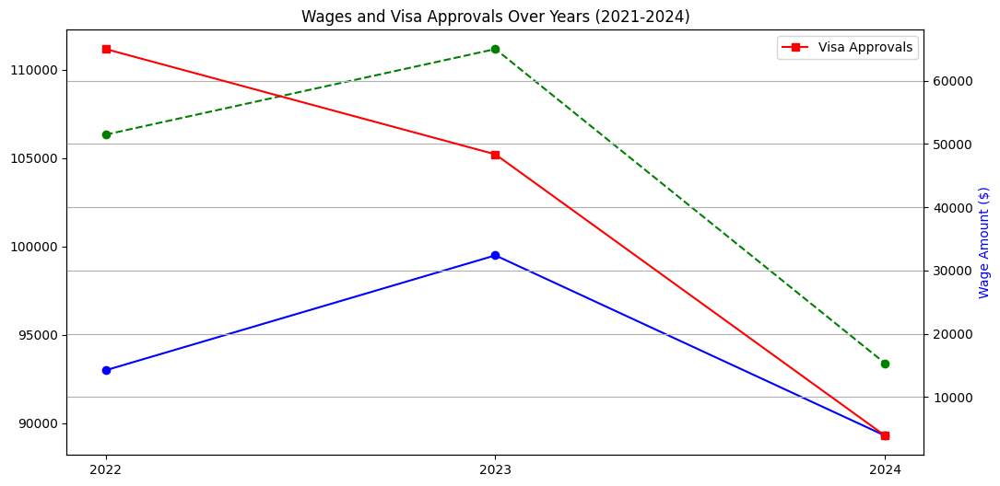

In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming data is already loaded in a dataframe called `df_combined` with columns: year, WAGE_AMT, and visa_approval_status
# Filter relevant years
df_filtered = df_combined[df_combined['year'].isin([2021, 2022, 2023, 2024])]

# Ensure WAGE_AMT is numeric
df_filtered['WAGE_AMT'] = pd.to_numeric(df_filtered['WAGE_AMT'], errors='coerce')
df_filtered = df_filtered.dropna(subset=['WAGE_AMT'])

# Calculate yearly statistics for wages
yearly_wages = df_filtered.groupby('year')['WAGE_AMT'].agg(['median', 'mean']).reset_index()

# Count the number of visa approvals by year
yearly_visa_approvals = df_filtered[df_filtered['FIRST_DECISION'] == 'Approved'].groupby('year').size().reset_index(name='visa_approvals')

# Merge wage and visa approval data for plotting
yearly_data = pd.merge(yearly_wages, yearly_visa_approvals, on='year')

# Create line chart for median/mean wages and visa approvals
plt.figure(figsize=(12, 6))

# Line for median wage
plt.plot(yearly_data['year'], yearly_data['median'], marker='o', label='Median Wage', color='blue')

# Line for mean wage
plt.plot(yearly_data['year'], yearly_data['mean'], marker='o', label='Mean Wage', linestyle='--', color='green')

# Line for visa approvals (secondary axis)
plt.twinx()  # Create a twin y-axis
plt.plot(yearly_data['year'], yearly_data['visa_approvals'], marker='s', label='Visa Approvals', color='red')

# Add titles, labels, and legend
plt.title('Wages and Visa Approvals Over Years (2021-2024)')
plt.xlabel('Year')
plt.ylabel('Visa Approvals', color='red')
plt.ylabel('Wage Amount ($)', color='blue')
plt.xticks(yearly_data['year'])
plt.grid(True)
plt.legend()
plt.show()

# Conclusion

The data pertains to H1-B visa applications, focusing on approvals, denials, top employers, and trends over time. It includes attributes like employer names, visa statuses, decision dates, wage amount, job titles, and state-level distributions, offering insights into visa-related dynamics in the U.S.

### Visualization channels:

Choropleth Map visualizes the number of approved H1-B applications by state for the year 2023-2024, using a blue gradient to indicate varying levels of approvals. We can hover over states to see high level top statistics and then click on any state to see a drill down in the form of a bar chart.

The bar chart highlights the top employers in the selected state based on the number of H1-B visas approved for the year 2023-2024.

Based on which employer is selected a line chart shows the trends over time of approval rate of H1B visa's. On hovering over the points we can see information like the total number of applications, the top job title and the median salary amount.

# References

https://www.bloomberg.com/graphics/2024-staffing-firms-game-h1b-visa-lottery-system/